# Explore the AUG workflow and single flux tube UQ data sets

- this uses 
  - AUG_mix-lim_gem_inoutput.txt
  - AUG_mix-lim_gem_flux_area.txt

## A fairly standard set of imports

In [1]:
%matplotlib inline
#%matplotlib notebook
import os
import matplotlib
if not os.getenv("DISPLAY"): matplotlib.use('Agg')
import matplotlib.pylab as plt
from IPython.display import set_matplotlib_formats
set_matplotlib_formats('png', 'pdf')
import numpy as np
import pandas as pd
pd.options.display.max_rows = 128
from utility import _ewma, plot_smoothed, plot_unsmoothed

/tmp/ipykernel_10319/2400050242.py:8: DeprecationWarning: `set_matplotlib_formats` is deprecated since IPython 7.23, directly use `matplotlib_inline.backend_inline.set_matplotlib_formats()`
  set_matplotlib_formats('png', 'pdf')


## Read and examine the workflow data

In [2]:
# read the data from the AUG workflow runs
AUG_gem_wf = pd.read_table('../../data/AUG_mix-lim_gem_inoutput.txt', delimiter='  *', engine='python')
AUG_gem_pb = pd.read_table('../../data/AUG_mix-lim_flux_area.txt', delimiter='  *', engine='python') 

In [3]:
AUG_gem_wf.describe().T

,count,mean,std,min,25%,50%,75%,max
time,59899.0,2.912920e+00,1.536715e+00,9.950002e-01,1.739285e+00,2.481328e+00,3.870171e+00,6.714491e+00
Te-ft1,59899.0,2.546936e+03,1.308598e+02,2.163673e+03,2.447980e+03,2.519935e+03,2.685309e+03,2.813277e+03
Te-ft2,59899.0,2.121124e+03,1.285837e+02,1.909920e+03,2.017109e+03,2.045565e+03,2.280764e+03,2.340730e+03
Te-ft3,59899.0,1.575245e+03,4.710705e+01,1.479660e+03,1.528592e+03,1.582403e+03,1.615879e+03,1.697965e+03
Te-ft4,59899.0,1.210471e+03,4.981199e+01,1.139884e+03,1.177271e+03,1.190443e+03,1.228192e+03,1.416408e+03
Te-ft5,59899.0,9.626367e+02,5.148367e+01,8.744209e+02,9.252093e+02,9.403654e+02,9.913869e+02,1.185960e+03
Te-ft6,59899.0,7.535377e+02,3.822600e+01,6.761856e+02,7.249401e+02,7.409673e+02,7.771060e+02,9.655860e+02
Te-ft7,59899.0,5.537494e+02,2.049541e+01,5.029950e+02,5.393429e+02,5.506129e+02,5.668042e+02,7.558942e+02
Te-ft8,59899.0,2.777764e+02,9.289055e+00,2.556397e+02,2.729525e+02,2.772331e+02,2.818279e+02,5.335908e+02
dTe-ft1,59899.0,-1.931039e+03,4.378854e+02,-3.216790e+03,-2.240892e+03,-1.760362e+03,-1.607440e+03,-9.928219e+02


In [4]:
AUG_gem_pb.describe().T

,count,mean,std,min,25%,50%,75%,max
time,59899.0,2.912920e+00,1.536715,9.950002e-01,1.739285e+00,2.481328e+00,3.870171e+00,6.714491e+00
Te-source-int-ft1,59899.0,1.186123e+05,2035.601130,1.142271e+05,1.171360e+05,1.187435e+05,1.204071e+05,1.250258e+05
Te-source-int-ft2,59899.0,4.870428e+05,7640.057877,4.738330e+05,4.809334e+05,4.869514e+05,4.933333e+05,5.315079e+05
Te-source-int-ft3,59899.0,8.684851e+05,11617.627807,8.486977e+05,8.594041e+05,8.685775e+05,8.764381e+05,9.631281e+05
Te-source-int-ft4,59899.0,1.202969e+06,15507.616178,1.178334e+06,1.190797e+06,1.202512e+06,1.213515e+06,1.353262e+06
Te-source-int-ft5,59899.0,1.475341e+06,20560.053536,1.443025e+06,1.458387e+06,1.475013e+06,1.489847e+06,1.683316e+06
Te-source-int-ft6,59899.0,1.685263e+06,27945.667745,1.633767e+06,1.661734e+06,1.685965e+06,1.706022e+06,1.949279e+06
Te-source-int-ft7,59899.0,1.843396e+06,38813.351497,1.768600e+06,1.809214e+06,1.846368e+06,1.874494e+06,2.167477e+06
Te-source-int-ft8,59899.0,1.989465e+06,52985.676391,1.878878e+06,1.941443e+06,1.995186e+06,2.034589e+06,2.372746e+06
Ti-source-int-ft1,59899.0,1.436815e+05,1034.623538,1.354702e+05,1.430856e+05,1.437014e+05,1.443284e+05,1.462286e+05


### Set up some column selections

In [5]:
active_t = []
active_t.append(['time', 'Te-ft1', 'dTe-ft1', 'Ti-ft1', 'dTi-ft1', 'flux-Te-ft1', 'flux-Ti-ft1'])
active_t.append(['time', 'Te-ft2', 'dTe-ft2', 'Ti-ft2', 'dTi-ft2', 'flux-Te-ft2', 'flux-Ti-ft2'])
active_t.append(['time', 'Te-ft3', 'dTe-ft3', 'Ti-ft3', 'dTi-ft3', 'flux-Te-ft3', 'flux-Ti-ft3'])
active_t.append(['time', 'Te-ft4', 'dTe-ft4', 'Ti-ft4', 'dTi-ft4', 'flux-Te-ft4', 'flux-Ti-ft4'])
active_t.append(['time', 'Te-ft5', 'dTe-ft5', 'Ti-ft5', 'dTi-ft5', 'flux-Te-ft5', 'flux-Ti-ft5'])
active_t.append(['time', 'Te-ft6', 'dTe-ft6', 'Ti-ft6', 'dTi-ft6', 'flux-Te-ft6', 'flux-Ti-ft6'])
active_t.append(['time', 'Te-ft7', 'dTe-ft7', 'Ti-ft7', 'dTi-ft7', 'flux-Te-ft7', 'flux-Ti-ft7'])
active_t.append(['time', 'Te-ft8', 'dTe-ft8', 'Ti-ft8', 'dTi-ft8', 'flux-Te-ft8', 'flux-Ti-ft8'])

In [6]:
# setup some column groups 
Te_cols = ['Te-ft1', 'Te-ft2', 'Te-ft3', 'Te-ft4', 'Te-ft5', 'Te-ft6', 'Te-ft7', 'Te-ft8']
Ti_cols = ['Ti-ft1', 'Ti-ft2', 'Ti-ft3', 'Ti-ft4', 'Ti-ft5', 'Ti-ft6', 'Ti-ft7', 'Ti-ft8']
dTe_cols = ['dTe-ft1', 'dTe-ft2', 'dTe-ft3', 'dTe-ft4', 'dTe-ft5', 'dTe-ft6', 'dTe-ft7', 'dTe-ft8']
dTi_cols = ['dTi-ft1', 'dTi-ft2', 'dTi-ft3', 'dTi-ft4', 'dTi-ft5', 'dTi-ft6', 'dTi-ft7', 'dTi-ft8']
Te_flux_cols = ['flux-Te-ft1', 'flux-Te-ft2', 'flux-Te-ft3', 'flux-Te-ft4', 
                'flux-Te-ft5', 'flux-Te-ft6', 'flux-Te-ft7', 'flux-Te-ft8'] 
Ti_flux_cols = ['flux-Ti-ft1', 'flux-Ti-ft2', 'flux-Ti-ft3', 'flux-Ti-ft4', 
                'flux-Ti-ft5', 'flux-Ti-ft6', 'flux-Ti-ft7', 'flux-Ti-ft8']
ne_cols = ['ne-ft1', 'ne-ft2', 'ne-ft3', 'ne-ft4', 'ne-ft5', 'ne-ft6', 'ne-ft7', 'ne-ft8']
dne_cols = ['dne-ft1', 'dne-ft2', 'dne-ft3', 'dne-ft4', 'dne-ft5', 'dne-ft6', 'dne-ft7', 'dne-ft8']
ne_flux_cols = ['flux-ne-ft1', 'flux-ne-ft2', 'flux-ne-ft3', 'flux-ne-ft4', 
                'flux-ne-ft5', 'flux-ne-ft6', 'flux-ne-ft7', 'flux-ne-ft8']
cp_Te_flux_cols = ['cp-flux-Te-ft1', 'cp-flux-Te-ft2', 'cp-flux-Te-ft3', 'cp-flux-Te-ft4', 
                   'cp-flux-Te-ft5', 'cp-flux-Te-ft6', 'cp-flux-Te-ft7', 'cp-flux-Te-ft8'] 
cp_Ti_flux_cols = ['cp-flux-Ti-ft1', 'cp-flux-Ti-ft2', 'cp-flux-Ti-ft3', 'cp-flux-Ti-ft4', 
                   'cp-flux-Ti-ft5', 'cp-flux-Ti-ft6', 'cp-flux-Ti-ft7', 'cp-flux-Ti-ft8']
cp_ne_flux_cols = ['cp-flux-ne-ft1', 'cp-flux-ne-ft2', 'cp-flux-ne-ft3', 'cp-flux-ne-ft4', 
                   'cp-flux-ne-ft5', 'cp-flux-ne-ft6', 'cp-flux-ne-ft7', 'cp-flux-ne-ft8']

In [7]:
# setup some column groups 
dvdrho_cols = ['dvdrho1', 'dvdrho2', 'dvdrho3', 'dvdrho4', 'dvdrho5', 'dvdrho6', 'dvdrho7', 'dvdrho8']
surfaceA_cols = ['surfaceA1', 'surfaceA2', 'surfaceA3', 'surfaceA4', 
                 'surfaceA5', 'surfaceA6', 'surfaceA7', 'surfaceA8']
Te_source_int_cols = ['Te-source-int-ft1', 'Te-source-int-ft2', 'Te-source-int-ft3', 'Te-source-int-ft4', 
                      'Te-source-int-ft5', 'Te-source-int-ft6', 'Te-source-int-ft7', 'Te-source-int-ft8'] 
Ti_source_int_cols = ['Ti-source-int-ft1', 'Ti-source-int-ft2', 'Ti-source-int-ft3', 'Ti-source-int-ft4', 
                      'Ti-source-int-ft5', 'Ti-source-int-ft6', 'Ti-source-int-ft7', 'Ti-source-int-ft8']
E_source_int_cols = ['E-source-int-ft1', 'E-source-int-ft2', 'E-source-int-ft3', 'E-source-int-ft4', 
                     'E-source-int-ft5', 'E-source-int-ft6', 'E-source-int-ft7', 'E-source-int-ft8']
E_flux_cols = ['flux-E-ft1', 'flux-E-ft2', 'flux-E-ft3', 'flux-E-ft4', 
               'flux-E-ft5', 'flux-E-ft6', 'flux-E-ft7', 'flux-E-ft8']
cp_E_flux_cols = ['cp-flux-E-ft1', 'cp-flux-E-ft2', 'cp-flux-E-ft3', 'cp-flux-E-ft4', 
                  'cp-flux-E-ft5', 'cp-flux-E-ft6', 'cp-flux-E-ft7', 'cp-flux-E-ft8']

## Add some columns for comparing the "power-balance" transport coefficients

In [8]:
AUG_gem_pb[E_source_int_cols] = np.array(AUG_gem_pb[Te_source_int_cols]) + np.array(AUG_gem_pb[Ti_source_int_cols])
AUG_gem_pb[Te_flux_cols] = np.array(AUG_gem_pb[Te_source_int_cols]) ## / np.array(AUG_gem_pb[surfaceA_cols])
AUG_gem_pb[Ti_flux_cols] = np.array(AUG_gem_pb[Ti_source_int_cols]) ## / np.array(AUG_gem_pb[surfaceA_cols])
AUG_gem_pb[E_flux_cols] = np.array(AUG_gem_pb[E_source_int_cols]) ## / np.array(AUG_gem_pb[surfaceA_cols])
#AUG_gem_wf[E_flux_cols] = np.array(AUG_gem_wf[Te_flux_cols]) + np.array(AUG_gem_wf[Ti_flux_cols])
AUG_gem_wf[E_flux_cols] = np.array(AUG_gem_wf[cp_Te_flux_cols]) + np.array(AUG_gem_wf[cp_Ti_flux_cols])


In [9]:
AUG_gem_pb[E_flux_cols].describe().T

,count,mean,std,min,25%,50%,75%,max
flux-E-ft1,59899.0,2.622939e+05,2157.539870,2.593750e+05,2.601280e+05,2.616775e+05,2.645852e+05,2.662119e+05
flux-E-ft2,59899.0,1.116262e+06,7954.727486,1.106442e+06,1.108296e+06,1.113738e+06,1.124812e+06,1.130299e+06
flux-E-ft3,59899.0,2.039084e+06,11105.304207,2.024732e+06,2.028472e+06,2.035058e+06,2.051140e+06,2.059395e+06
flux-E-ft4,59899.0,2.880943e+06,10344.457274,2.867720e+06,2.871408e+06,2.876390e+06,2.892060e+06,2.903356e+06
flux-E-ft5,59899.0,3.589441e+06,7824.149807,3.578099e+06,3.582237e+06,3.587035e+06,3.597686e+06,3.615872e+06
flux-E-ft6,59899.0,4.153347e+06,5093.590443,4.145067e+06,4.148174e+06,4.152995e+06,4.158062e+06,4.185408e+06
flux-E-ft7,59899.0,4.583004e+06,4194.161020,4.570638e+06,4.579076e+06,4.583151e+06,4.585015e+06,4.619569e+06
flux-E-ft8,59899.0,4.897805e+06,6144.443604,4.871413e+06,4.893429e+06,4.895335e+06,4.900433e+06,4.942748e+06


## Plot some of the "power-balance" columns

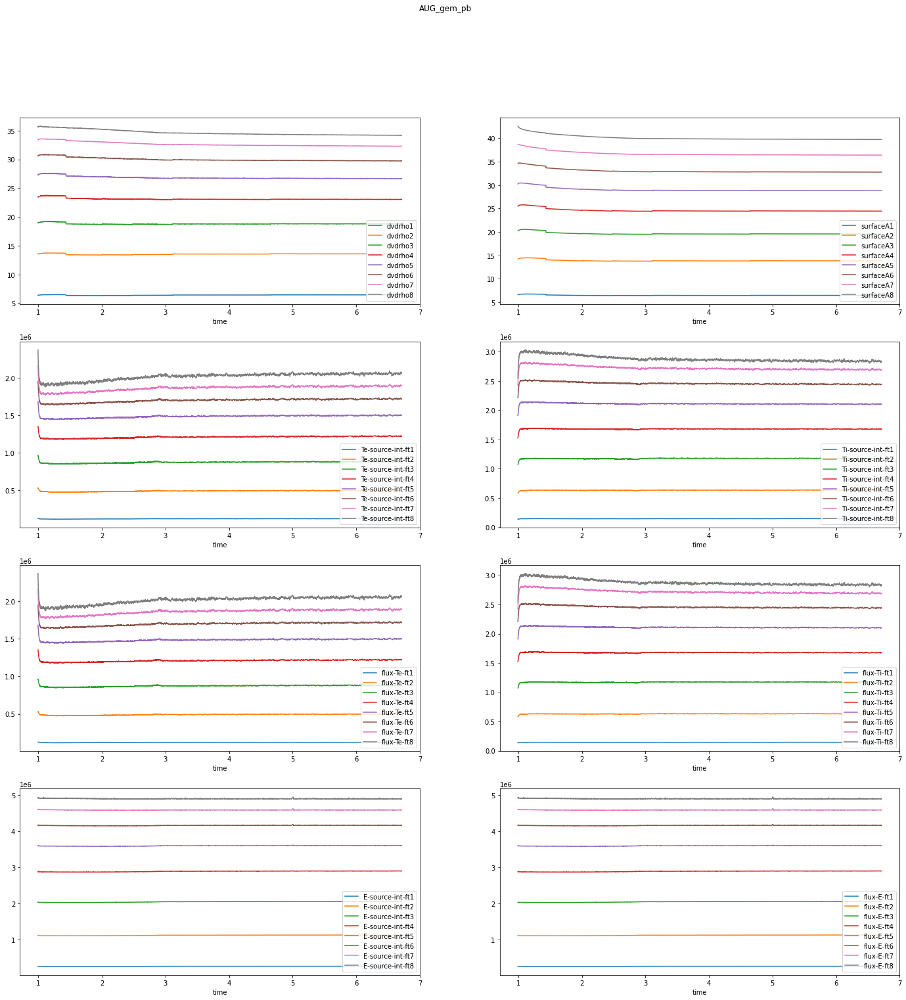

In [10]:
fig, ax = plt.subplots(4, 2, figsize=(24,24))
AUG_gem_pb.plot(x='time', y=dvdrho_cols, ax=ax[0,0])
AUG_gem_pb.plot(x='time', y=surfaceA_cols, ax=ax[0,1])
AUG_gem_pb.plot(x='time', y=Te_source_int_cols, ax=ax[1,0])
AUG_gem_pb.plot(x='time', y=Ti_source_int_cols, ax=ax[1,1])
AUG_gem_pb.plot(x='time', y=Te_flux_cols, ax=ax[2,0])
AUG_gem_pb.plot(x='time', y=Ti_flux_cols, ax=ax[2,1])
AUG_gem_pb.plot(x='time', y=E_source_int_cols, ax=ax[3,0])
AUG_gem_pb.plot(x='time', y=E_flux_cols, ax=ax[3,1])
plt.suptitle('AUG_gem_pb');

## Flux tube electron and ion energy fluxes

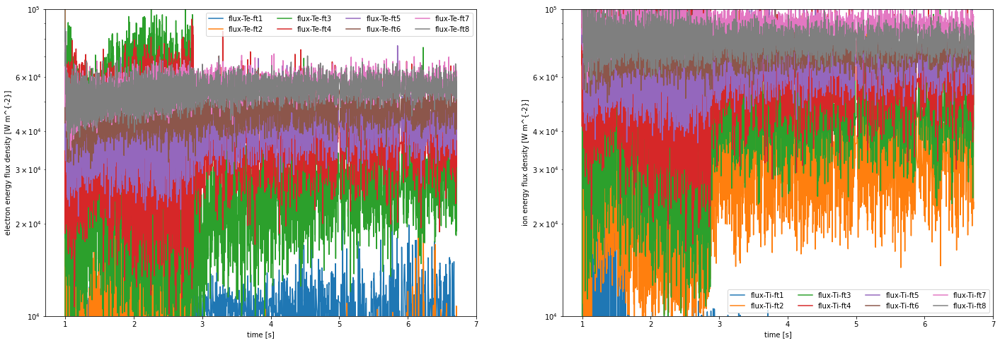

In [11]:
plot_unsmoothed(
    [{"data": AUG_gem_wf, "style": '-'}],
    [{"cols": Te_flux_cols, "label": 'electron energy flux density [W m^{-2}]', "limit": (1e4,1e5)},
     {"cols": Ti_flux_cols, "label": 'ion energy flux density [W m^{-2}]', "limit": (1e4,1e5)}],
    logy=True)

## Flux tube Te & Ti

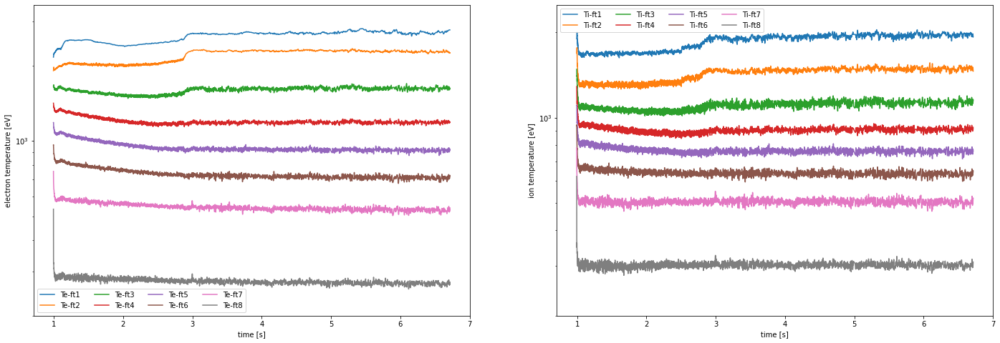

In [12]:
plot_unsmoothed(
    [{"data": AUG_gem_wf, "style": '-'}],
    [{"cols": Te_cols, "label": 'electron temperature [eV]', "limit": (200,3500)},
     {"cols": Ti_cols, "label": 'ion temperature [eV]', "limit": (200,2500)}])

## Flux tube dTe & dTi

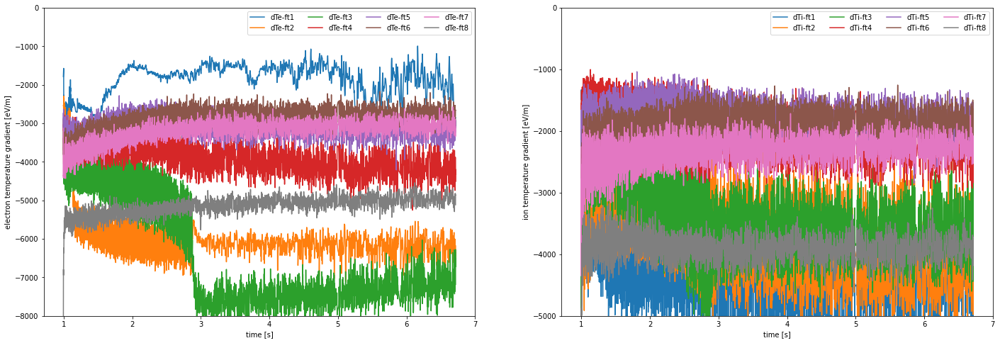

In [13]:
plot_unsmoothed(
    [{"data": AUG_gem_wf, "style": '-'}],
    [{"cols": dTe_cols, "label": 'electron temperature gradient [eV/m]', "limit": (-8000,0)},
     {"cols": dTi_cols, "label": 'ion temperature gradient [eV/m]', "limit": (-5000,0)}],
    logy=False)

## Flux tube ne & dne (not evolved so should be pretty much constant)

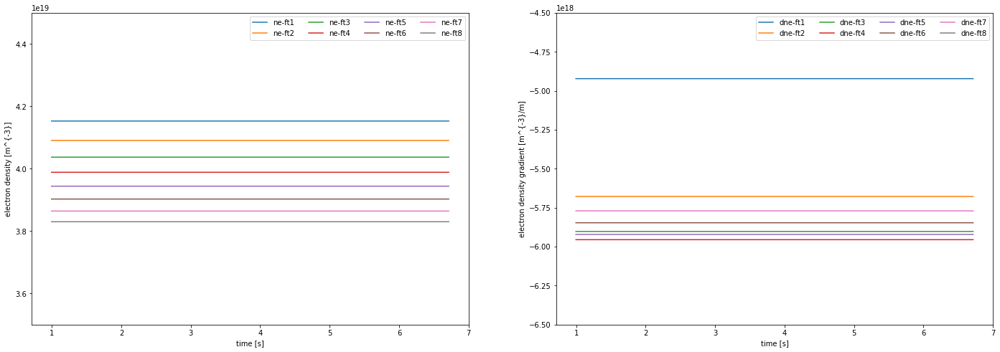

In [14]:
plot_unsmoothed(
    [{"data": AUG_gem_wf, "style": '-'}],
    [{"cols": ne_cols, "label": 'electron density [m^{-3}]', "limit": (3.5e19,4.5e19)},
     {"cols": dne_cols, "label": 'electron density gradient [m^{-3}/m]', "limit": (-0.65e19,-0.45e19)}],
    logy=False)

## Flux tube ne fluxes

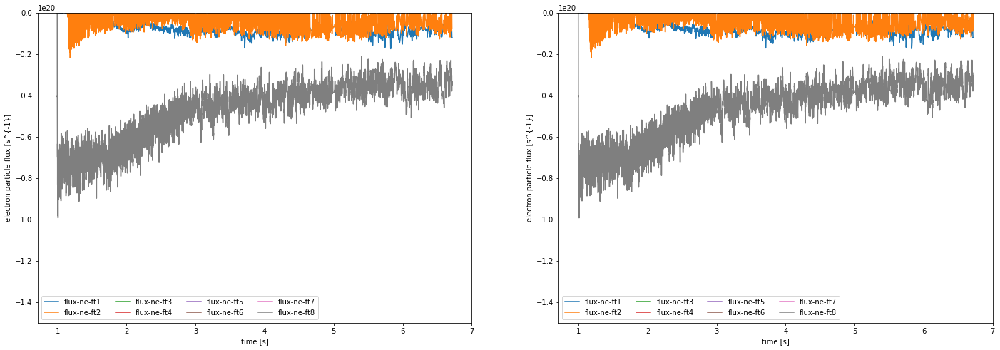

In [15]:
plot_unsmoothed(
    [{"data": AUG_gem_wf, "style": '-'}],
    [{"cols": ne_flux_cols, "label": 'electron particle flux [s^{-1}]', "limit": (-1.5e20,0e20)},
     {"cols": ne_flux_cols, "label": 'electron particle flux [s^{-1}]', "limit": (-1.5e20,0e20)}],
    logy=False)

## Summed energy fluxes

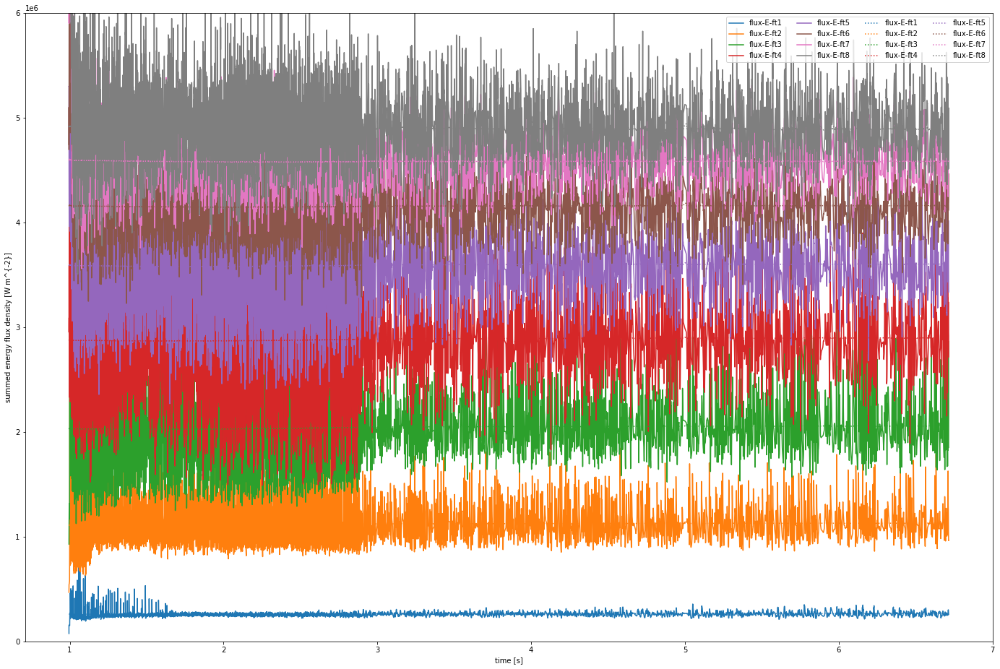

In [16]:
plot_unsmoothed(
    [{"data": AUG_gem_wf, "style": '-'}, {"data": AUG_gem_pb, "style": ':'}],
    [{"cols": E_flux_cols, "label": 'summed energy flux density [W m^{-2}]', "limit": (0e4,6e6)}],
    logy=False, figsize=(24,16))

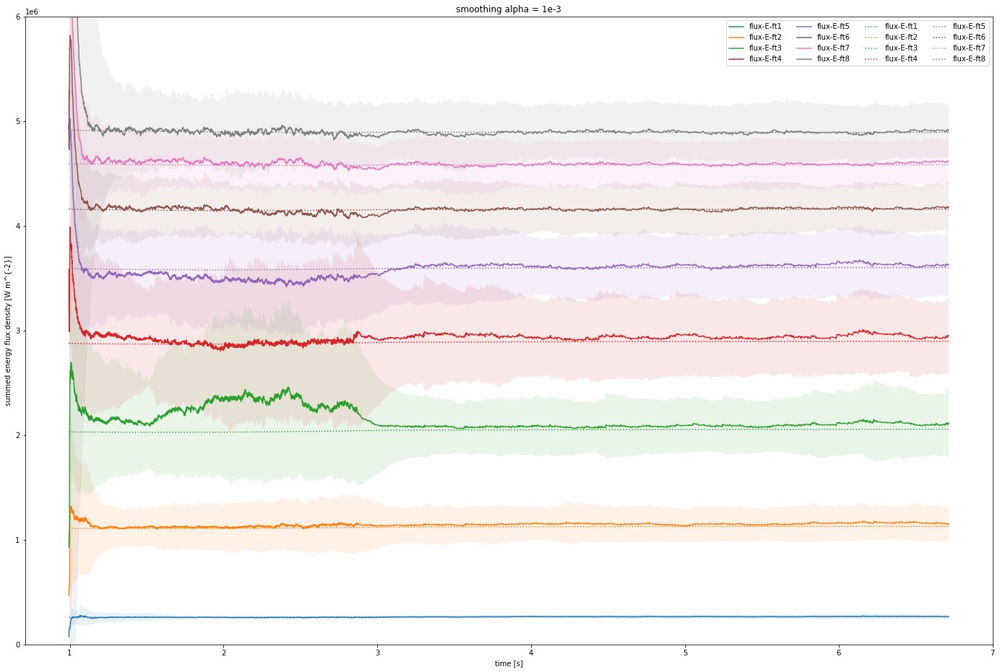

In [17]:
plot_smoothed(
    [{"data": AUG_gem_wf, "style": '-'}, {"data": AUG_gem_pb, "style": ':'}],
    [{"cols": E_flux_cols, "label": 'summed energy flux density [W m^{-2}]', "limit": (0e4,6e6)}],
    logy=False, figsize=(24,16))

## Histograms of energy fluxes

In [18]:
CorrFac = np.array([1.03999752, 1.05092586, 1.06618315, 1.08478152, 1.10574832,
       1.12937492, 1.15678054, 1.19109317])
ConvFlux = 1.5 * np.array([ 6245.99024853, 11378.80341194, 13262.82115728, 13228.95249612,
       11956.42601699,  9881.26452619,  7287.47402199,  4258.16894439])
Surface = np.array([ 6.61697437, 14.21520929, 20.2323399 , 25.48157489, 30.22466848,
       34.59816126, 38.68713401, 42.5575824 ])
#print(np.array(AUG_gem_wf[E_flux_cols])[-1] / CorrFac + ConvFlux)
#print(np.array(AUG_gem_pb[E_source_int_cols])[-1]/Surface)
#print((np.array(AUG_gem_pb[E_source_int_cols])[-1]/Surface - ConvFlux) * CorrFac)
#print(np.array(AUG_gem_wf[E_flux_cols])[-1])
Revised_PB_energy = (np.array(AUG_gem_pb[E_source_int_cols])/Surface - ConvFlux) * CorrFac
print(Revised_PB_energy[-1])
# AUG_gem_wf[E_flux_cols] = Revised_PB_energy

[ 32074.66454285  65513.81853974  87131.98354297 101817.82455899
 111928.86257947 119051.62391363 124417.66851221 129328.67799419]


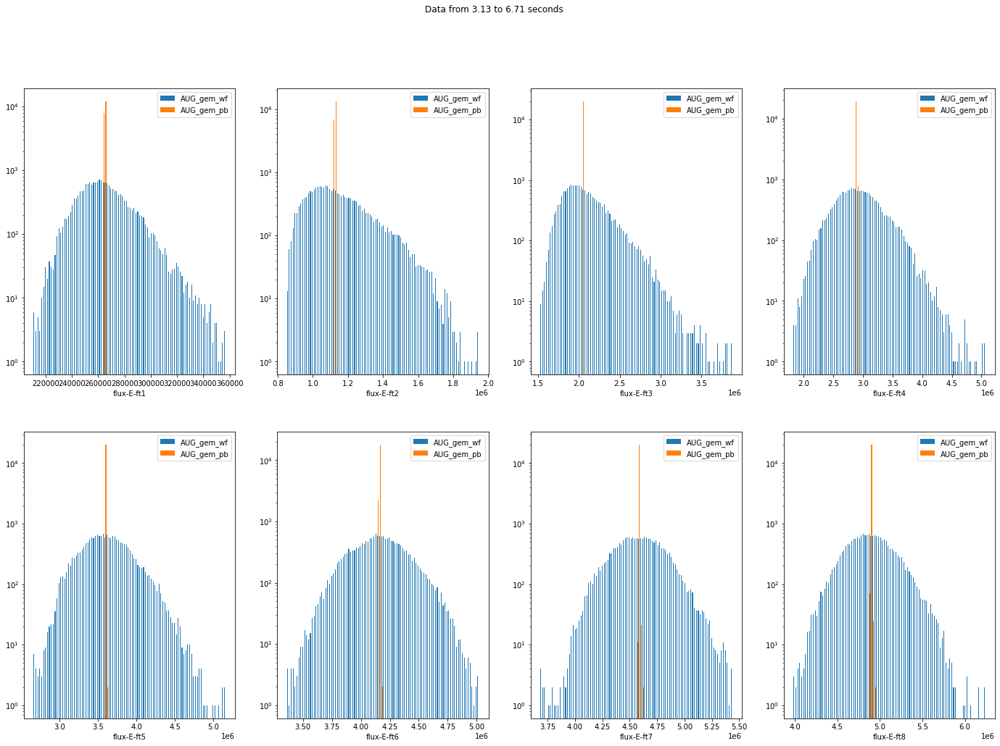

In [19]:
plt.subplots(2,4,figsize=(24,16))
offset=40000
for i in range(8):
    L = E_flux_cols[i]
    plt.subplot(2,4,i+1)
    plt.hist([AUG_gem_wf[L][offset:], AUG_gem_pb[L][offset:]], bins=100, 
             label=['AUG_gem_wf', 'AUG_gem_pb'], log=True);
    plt.xlabel(L)
    plt.legend()
plt.suptitle('Data from %0.2f to %0.2f seconds' % 
             (AUG_gem_wf['time'][offset:].min(), AUG_gem_wf['time'][offset:].max()));

InvalidIndexError: (slice(None, None, None), None)

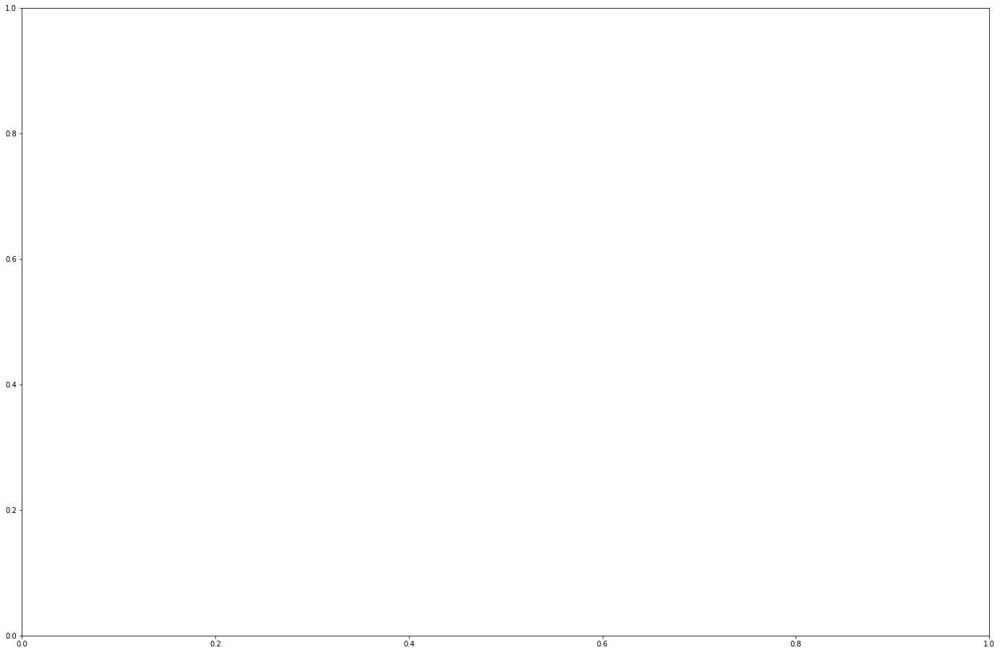

In [20]:
plt.figure(figsize=(24,16))
plt.plot(AUG_gem_wf.time, AUG_gem_wf[E_flux_cols]/AUG_gem_pb[E_flux_cols])
plt.legend(loc=0, labels=E_flux_cols, ncol=4)
plt.xlabel('Time'); plt.ylabel('wf/pb energy flux'); plt.ylim(0.5, 2.0); plt.suptitle('Standard Power Balance');

# The End

In [ ]:
import utility, importlib
importlib.reload(utility)
from utility import _ewma, plot_smoothed, plot_unsmoothed